# Airlines, Delays and Angry Tweets

The basis of this exercise is to analyze the distribution of the airlines related tweets and its sentiments, trying to answer questions such as which company has a more positive/negative sentiment overall, how the sentiment is related to time or location or how everything is related to the amount of travels a certain company performs. We will emphatize dimensions such as the airline related to the tweet, the datetime of the tweet or its location. We are also provided with a second data source where delays of some airlines operating in the US is provided, therefore we may see if the airlines which report the most delays and/or cancellations are the ones that people complain the most on Twitter.

To perform this analysis we are going to use mostly visual data commented, but the data is easily accessed as Pandas' DataFrame in case the reader wants to check it in a tabular form too.

The main steps of this analysis are the following:
1. Data Loading
2. Data Description
3. Using the Data to solve our questions
4. Conclusions

## Imports Needed

In [1]:
import warnings
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from wordcloud import WordCloud, STOPWORDS
import statsmodels.formula.api as smf
pd.set_option('display.max_columns', None)
warnings.filterwarnings('ignore')
%matplotlib inline

## Function Declaration

In [2]:
def heatmap_na_values(df: pd.DataFrame) -> None:
    """ Plot the presence of missing values inside the dataframe as a heatmap
    
    :param df: Pandas DataFrame to plot its missing values
    :return: None
    """
    
    fig, ax = plt.subplots(figsize=(14, 8))
    sns.heatmap(df.isnull(), cbar=False, yticklabels='', ax=ax)
    plt.show()
    
    return None


def heatmap_corr_values(df: pd.DataFrame) -> None:
    """ Plot the correlation between values inside the dataframe as a heatmap
    
    :param df: Pandas DataFrame to plot its correlations 
    :return: None
    """
    
    fig, ax = plt.subplots(figsize=(14, 8))
    sns.heatmap(df.corr(), cbar=True, annot=True, ax=ax)
    plt.show()
    
    return None


def plotly_counts(df: pd.DataFrame, category: str, hue: str, title: str) -> plotly.graph_objs._figure.Figure:
    """ Returns a plotly figure with a countplot according to the args provided
    
    :param df: DataFrame that contains the information
    :param category: Name of the category column
    :param hue: Name of the color column
    :param title: Title of the plot
    :return: Plotly countplot
    """
    
    fig = px.histogram(df, x=category, color=hue, title=title)
    fig.update_layout(xaxis={'categoryorder': 'array',
                             'categoryarray': df[category].value_counts().index})
    
    return fig


def plotly_dist_numcols(df: pd.DataFrame, numcols: list, plot_type: str, title: str) -> plotly.graph_objs._figure.Figure:
    """ Returns a plotly figure withn n = len(numcols) subplots with Boxplots
    
    :param df: DataFrame that contains the information
    :param numcols: List of numerical columns to represent
    :param plot_type: Type of distribution plot to perform, valid parameters=['hist','box']
    :param title: Title of the plot
    :return: Plotly Figure with Boxplots inside
    """
    
    # Number of rows to have
    nrows = len(numcols)
    fig = make_subplots(rows=nrows)
    
    # Iter every column and add the trace
    numrow = 1
    if plot_type == 'hist':
        for col in numcols:
            fig.add_trace(
                go.Histogram(x=df[col],
                             name=col),
                row=numrow, col=1
            )
            # Increment numrow 
            numrow += 1

    elif plot_type == 'box':
        for col in numcols:
            fig.add_trace(
                go.Box(x=df[col],
                       name=col),
                row=numrow, col=1
            )
            # Increment numrow 
            numrow += 1
            
    else:
        raise Exception('No valid plot_type has been provided')
        
    fig.update_layout(title=title)
    
    return fig


def plotly_percentage_grouped(df: pd.DataFrame, variable: str, hue: str, title: str) -> plotly.graph_objs._figure.Figure:
    """ Returns a plotly figure withn n = len(numcols) subplots with Boxplots
    
    :param df: DataFrame that contains the information
    :param variable: Column to represent as X axis
    :param hue: Name of the color column
    :param title: Title of the plot
    :return: Plotly Figure with Boxplots inside
    """
    
    # Grouping 
    grouped = df.groupby([variable, hue]).agg({'tweet_id': pd.Series.count}).unstack()
    totals = grouped.sum(axis=1)

    unique_variables = list(df[hue].unique())

    for var in unique_variables:
        grouped[f'{var} %'] = grouped[('tweet_id', var)] / totals * 100

    # Plotting barplot as percentage of total
    fig = go.Figure()
    for var in unique_variables:
        
        fig.add_trace(go.Scatter(
            x=grouped.index,
            y=grouped[f'{var} %'],
            mode='lines',
            line=dict(width=0.5),
            stackgroup='one',
            name=var
        ))

    fig.update_layout(
        showlegend=True,
        xaxis_type='category',
        yaxis=dict(
            type='linear',
            range=[1, 100],
            ticksuffix='%'),
        title=title)   
                      
    return fig


def wordcloud_sentiment(df: pd.DataFrame, sentiment: str, max_words: int, img_path: str) -> None:
    """ Plots a Wordcloud with the most frequent words referring to the sentiment referenced
    
    :param df: DataFrame that contains the information
    :param sentiment: Which sentiment tweets to plot
    :param max_words: Max number of words to plot
    :param img_path: Path to the image to use a mask
    :return: None
    """

    # Obtain the text to analyze
    f = df['airline_sentiment'] == sentiment
    text = " ".join(tweet.upper() for tweet in df[f]['text'])

    # Creation of a mask to plot our wordcloud
    mask = np.array(Image.open(img_path))
    transformed_mask = np.ndarray((mask.shape[0], mask.shape[1]), np.int32)
    for i in range(len(mask)):
        transformed_mask[i] = [255 if y==0 else y for y in transformed_mask[i]]
        
        
    # Stopwords not to be considered, including the names of the companies
    stopwords = set(STOPWORDS)
    stopwords.update(set(df['airline'].str.upper()))
    stopwords.update(set(df['airline'].apply(lambda x: ''.join(x.upper().split()))))
    
    # Generation of our wordcloud
    wordcloud = WordCloud(background_color="white", 
                          max_words=max_words, mask=transformed_mask,
                          stopwords=stopwords,
                          contour_width=3, contour_color='firebrick')
    wordcloud.generate(text)
    plt.figure(figsize=(20, 20))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()
    
    return None

## Data Loading 

In this ocassion we again face 2 different CSV files as data sources, and we should also start the analysis by loading these files as soon as possible to make the fun begin:

In [3]:
tweets = pd.read_csv('../data/Tweets.csv')

In [4]:
# Ensure data has been loaded correctly
tweets.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,570306133677760513,neutral,1.0000,NaN,NaN,Virgin America,NaN,cairdin,NaN,0,@VirginAmerica What @dhepburn said.,NaN,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada)
1,570301130888122368,positive,0.3486,NaN,0.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica plus you've added commercials t...,NaN,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada)
2,570301083672813571,neutral,0.6837,NaN,NaN,Virgin America,NaN,yvonnalynn,NaN,0,@VirginAmerica I didn't today... Must mean I n...,NaN,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,570301031407624196,negative,1.0000,Bad Flight,0.7033,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica it's really aggressive to blast...,NaN,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada)
4,570300817074462722,negative,1.0000,Can't Tell,1.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica and it's a really big bad thing...,NaN,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada)


In [5]:
airlines = pd.read_csv('../data/Delay_Airlines.csv')

In [6]:
# Ensure data has been loaded correctly
airlines.head()

,YEAR,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,UNIQUE_CARRIER,CARRIER,ORIGIN,DEST,DEP_TIME,DEP_DELAY,DEP_DEL15,ARR_TIME,ARR_DELAY,ARR_DEL15,CANCELLED,DIVERTED,AIR_TIME,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,Unnamed: 24
0,2015,2,1,7,2015-02-01,AA,AA,JFK,LAX,857.0,-3.0,0.0,1159.0,-36.0,0.0,0.0,0.0,323.0,2475.0,NaN,NaN,NaN,NaN,NaN,NaN
1,2015,2,2,1,2015-02-02,AA,AA,JFK,LAX,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,NaN,2475.0,NaN,NaN,NaN,NaN,NaN,NaN
2,2015,2,3,2,2015-02-03,AA,AA,JFK,LAX,856.0,-4.0,0.0,1227.0,-8.0,0.0,0.0,0.0,360.0,2475.0,NaN,NaN,NaN,NaN,NaN,NaN
3,2015,2,4,3,2015-02-04,AA,AA,JFK,LAX,855.0,-5.0,0.0,1224.0,-11.0,0.0,0.0,0.0,350.0,2475.0,NaN,NaN,NaN,NaN,NaN,NaN
4,2015,2,5,4,2015-02-05,AA,AA,JFK,LAX,853.0,-7.0,0.0,1225.0,-10.0,0.0,0.0,0.0,335.0,2475.0,NaN,NaN,NaN,NaN,NaN,NaN


## Data Description

I will use Pandas native methods combined with some basic visuals to take a glance at the data before getting our hands into work and answering the questions that are proposed. This set of functions, combined with some defined above, will allow us to perform a deep and easy analysis of the data:

### Tweets

#### Columns Description

In [7]:
tweets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14640 entries, 0 to 14639
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   tweet_id                      14640 non-null  int64  
 1   airline_sentiment             14640 non-null  object 
 2   airline_sentiment_confidence  14640 non-null  float64
 3   negativereason                9178 non-null   object 
 4   negativereason_confidence     10522 non-null  float64
 5   airline                       14640 non-null  object 
 6   airline_sentiment_gold        40 non-null     object 
 7   name                          14640 non-null  object 
 8   negativereason_gold           32 non-null     object 
 9   retweet_count                 14640 non-null  int64  
 10  text                          14640 non-null  object 
 11  tweet_coord                   1019 non-null   object 
 12  tweet_created                 14640 non-null  object 
 13  t

In [8]:
tweets.describe()

,tweet_id,airline_sentiment_confidence,negativereason_confidence,retweet_count
count,1.464000e+04,14640.000000,10522.000000,14640.000000
mean,5.692184e+17,0.900169,0.638298,0.082650
std,7.791112e+14,0.162830,0.330440,0.745778
min,5.675883e+17,0.335000,0.000000,0.000000
25%,5.685592e+17,0.692300,0.360600,0.000000
50%,5.694779e+17,1.000000,0.670600,0.000000
75%,5.698905e+17,1.000000,1.000000,0.000000
max,5.703106e+17,1.000000,1.000000,44.000000


We see 4 numerical columns and 11 columns stored as object, which considering the description of the fileds are expected to be strings, except for `tweet_created`. Some of these columns have a huge percentage of missing values, which induce me to think they are dependent of other columns (such as `negativereason` is dependent of `airline_sentiment`). We may represent this data more accurately and deal with some of it now:

#### NA Values

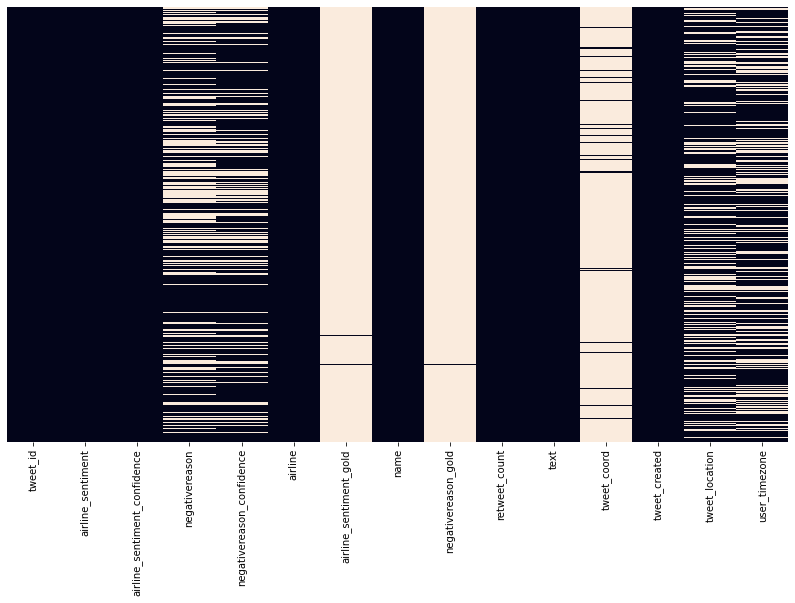

In [9]:
heatmap_na_values(tweets)

We see now clearly the impact of this missing values in the integrity of our dataset. As we may need some of the columns of our dataset to be completed later in order to visualize properly the data or to transform it, we are going to deal with the missing values the following way:
* For the column `negativereason` we are going to fill the NA values with the string 'No Negative Tweet' to identify the sentiment of the tweet as positive.
* For the column `negativereason_confidence` we are going to leave the column as is, even though with missing values, in order not to make the user infer anything other than the model that generated this data was not able to provide a scoring.
* For the columns `airline_sentiment_gold`, `negativereason_gold`, `tweet_coord`, `tweet_location` and `user_timezone` we are going to fill the values with the string 'UNKNOWN', which in this case is better than assigning the most common value or keeping the proportion of values of the column due to the high percentage of missing values in these columns.

In [10]:
# Perform the imputation of missing values
tweets['negativereason'] = tweets['negativereason'].fillna('No Negative Tweet')
unknown_impute_columns = [
    'airline_sentiment_gold', 
    'negativereason_gold',
    'tweet_coord', 
    'tweet_location',
    'user_timezone'
]
tweets[unknown_impute_columns] = tweets[unknown_impute_columns].fillna('UNKNOWN')

#### Categorical Variables

We may start our introductory analysis by looking at some of the categorical variables that seem more interesting at first glance:

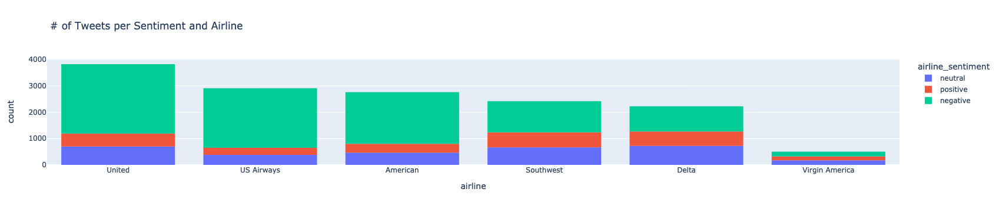

In [11]:
# Number of tweets about each airline according to their sentiment
fig = plotly_counts(tweets, 'airline', 'airline_sentiment', '# of Tweets per Sentiment and Airline')
fig.show()

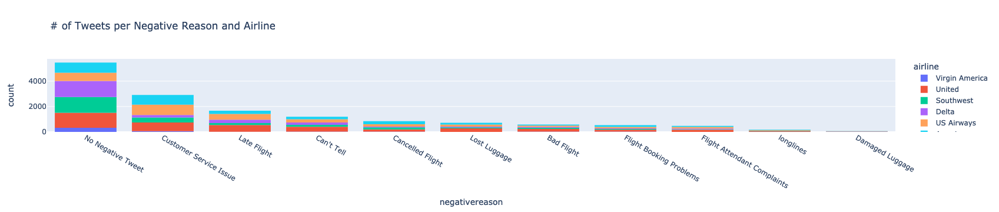

In [12]:
# Most common reasons
fig = plotly_counts(tweets, 'negativereason', 'airline', '# of Tweets per Negative Reason and Airline')
fig.show()

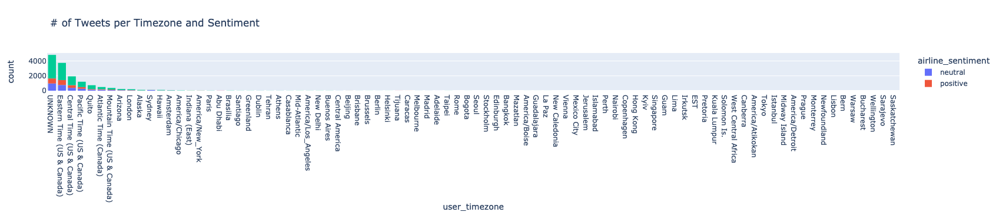

In [13]:
# Most common timezones (not locations due to high cardinality and noise of the tweet_location data)
fig = plotly_counts(tweets, 'user_timezone', 'airline_sentiment', '# of Tweets per Timezone and Sentiment')
fig.show()

- Most commented airlines are most critized too
- The most common reasons behind complaints are Customer Service, Late Flights, Cancelled Flights 
- Most of the data comes from North America

#### Numerical Values

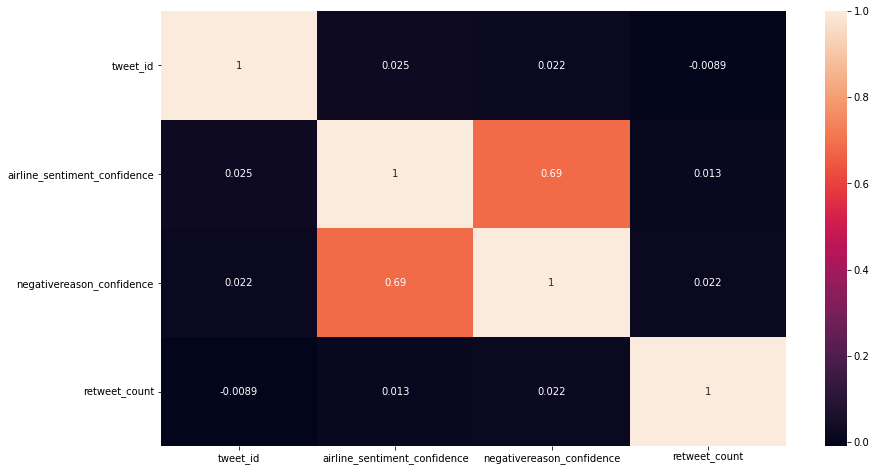

In [14]:
# Plotting correlation of variables
heatmap_corr_values(tweets)

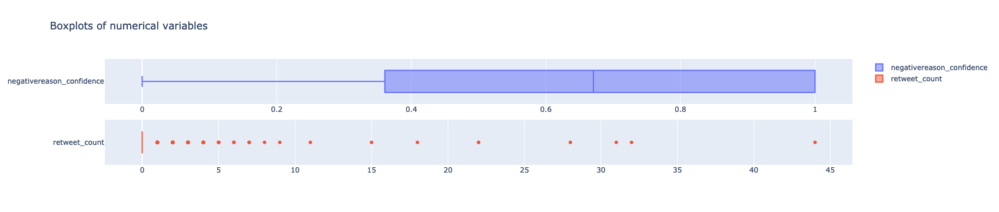

In [15]:
# Distribution of variables - Boxplots
numcols = [
    'negativereason_confidence',
    'retweet_count'
]
fig = plotly_dist_numcols(tweets, numcols, 'box', 'Boxplots of numerical variables')
fig.show()

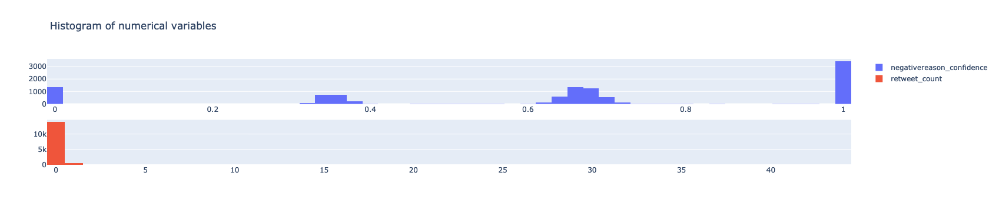

In [16]:
# Distribution of variables - Histograms
fig = plotly_dist_numcols(tweets, numcols, 'hist', 'Histogram of numerical variables')
fig.show()

- No correlation between confidence and number of retweets
- There is a predominance of high values for the negative confidence, meaning that the algorithm tends to classify tweets as negative (may be due to more predominant negative tweets, as [people tend to complain more than appraise](https://www.bizreport.com/2020/01/report-social-complaining-more-influential-than-praise.html))
- The 3 Quartiles of the `retweet_count` are 0, so most tweets have no retweets, and even for the ones that have some retweets there are only a few. Nevertheless there is a good number of outliers. The predominance of 0 value in this column means that they have no amplification and their network graph is reduced or inexistent.

### Airlines

#### Columns Description

In [17]:
airlines.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 429191 entries, 0 to 429190
Data columns (total 25 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   YEAR                 429191 non-null  int64  
 1   MONTH                429191 non-null  int64  
 2   DAY_OF_MONTH         429191 non-null  int64  
 3   DAY_OF_WEEK          429191 non-null  int64  
 4   FL_DATE              429191 non-null  object 
 5   UNIQUE_CARRIER       429191 non-null  object 
 6   CARRIER              429191 non-null  object 
 7   ORIGIN               429191 non-null  object 
 8   DEST                 429191 non-null  object 
 9   DEP_TIME             409132 non-null  float64
 10  DEP_DELAY            409132 non-null  float64
 11  DEP_DEL15            409132 non-null  float64
 12  ARR_TIME             408369 non-null  float64
 13  ARR_DELAY            407663 non-null  float64
 14  ARR_DEL15            407663 non-null  float64
 15  CANCELLED        

In [18]:
airlines.describe()

,YEAR,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,DEP_TIME,DEP_DELAY,DEP_DEL15,ARR_TIME,ARR_DELAY,ARR_DEL15,CANCELLED,DIVERTED,AIR_TIME,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,Unnamed: 24
count,429191.0,429191.0,429191.000000,429191.000000,409132.000000,409132.000000,409132.000000,408369.000000,407663.000000,407663.000000,429191.000000,429191.000000,407663.00000,429191.000000,95179.000000,95179.000000,95179.000000,95179.000000,95179.000000,0.0
mean,2015.0,2.0,14.601581,3.902675,1335.722351,11.885284,0.223126,1496.465586,8.320500,0.233475,0.047804,0.002356,112.59376,800.785450,17.994095,4.320964,14.175112,0.048120,22.672207,NaN
std,0.0,0.0,8.040341,1.976684,481.114683,40.143735,0.416343,505.436242,43.166529,0.423042,0.213351,0.048477,71.79941,591.732258,46.049191,26.758379,26.165485,1.555097,42.310737,NaN
min,2015.0,2.0,1.000000,1.000000,1.000000,-61.000000,0.000000,1.000000,-79.000000,0.000000,0.000000,0.000000,7.00000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
25%,2015.0,2.0,8.000000,2.000000,932.000000,-4.000000,0.000000,1119.000000,-12.000000,0.000000,0.000000,0.000000,60.00000,366.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
50%,2015.0,2.0,15.000000,4.000000,1330.000000,-1.000000,0.000000,1524.000000,-2.000000,0.000000,0.000000,0.000000,94.00000,641.000000,2.000000,0.000000,4.000000,0.000000,3.000000,NaN
75%,2015.0,2.0,22.000000,6.000000,1731.000000,11.000000,0.000000,1918.000000,13.000000,0.000000,0.000000,0.000000,144.00000,1045.000000,18.000000,0.000000,19.000000,0.000000,29.000000,NaN
max,2015.0,2.0,28.000000,7.000000,2400.000000,1587.000000,1.000000,2400.000000,1627.000000,1.000000,1.000000,1.000000,684.00000,4983.000000,1587.000000,1152.000000,748.000000,168.000000,1313.000000,NaN


At first glance, it may seem that the columns `CANCELLED` and `DIVERTED` are booleans with a bad encoding. We are going to check if that's the case and change its dtype if needed:

In [19]:
# Checking different values and its combinations
airlines[['CANCELLED', 'DIVERTED']].value_counts()

CANCELLED  DIVERTED
0.0        0.0         407663
1.0        0.0          20517
0.0        1.0           1011
dtype: int64

In [20]:
# Encoding these columns as booleans
airlines[['CANCELLED', 'DIVERTED']] = airlines[['CANCELLED', 'DIVERTED']].astype(bool)

Finally, we can say that we observe 17 numerical columns, 2 boolean columns and 5 columns stored as object, which again would represent strings (in this case categories only) except for `FL_DATE`, which represents the date of the flight. We also observe an extra column read by error on the file, which we should deal with as it has only missing values. The columns at the end of the DataFrame are full of missing values, and looking at the description of these variables we may infer that this is due to the fact that non delayed flights have indeed no information inside them. We now may further analyze this data and deal with those inconvenient missing values:

#### NA Values

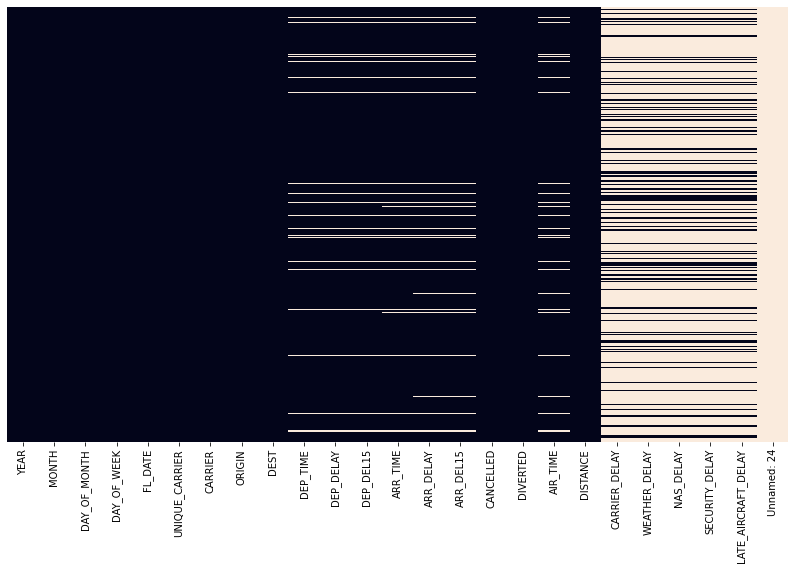

In [21]:
heatmap_na_values(airlines)

We see now clearly the impact of this missing values in the integrity of our dataset. As we may need some of the columns of our dataset to be completed later in order to visualize properly the data or to transform it, we are going to deal with the missing values the following way:
* For the column `Unnamed: 24` at the end of the file we are going to drop it.
* For the columns `CARRIER_DELAY`, `WEATHER_DELAY`, `HAS_DELAY`, `SECURITY_DELAY` and `LATE_AIRCRAFT_DELAY` we are going to fill the NA values with the value 0.0 to show the flight presented no noticeable delay.
* For the columns `DEEP_TIME`, `DEP_DELAY`, `DEP_DEL15`, `ARR_TIME`, `ARR_DELAY`, `ARR_DEL15` and `AIR_TIME` we are going to leave them as they are, because imputing some Unknown reference such as -1 would impact our metrics, and imputing its values would have effect on our analysis.

In [22]:
# Dropping the last column
airlines = airlines.iloc[:, :-1]

# Perform the imputation of missing values
no_delayed_impute_columns = [
    'CARRIER_DELAY',
    'WEATHER_DELAY',
    'NAS_DELAY',
    'SECURITY_DELAY',
    'LATE_AIRCRAFT_DELAY',
]
airlines[no_delayed_impute_columns] = airlines[no_delayed_impute_columns].fillna(0.0)

#### Categorical Variables

We may start our introductory analysis by looking at some of the categorical variables that seem more interesting at first glance:

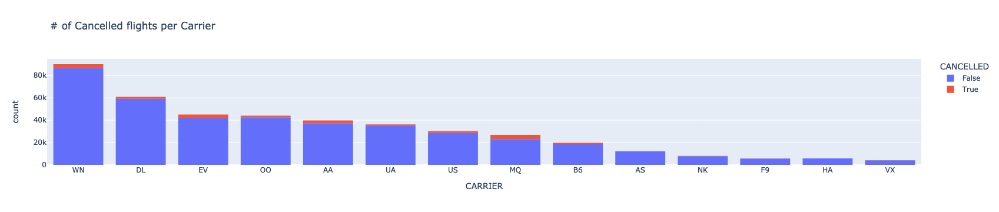

In [23]:
# Number of cancelled flights per carrier
fig = plotly_counts(airlines, 'CARRIER', 'CANCELLED', '# of Cancelled flights per Carrier')
fig.show()

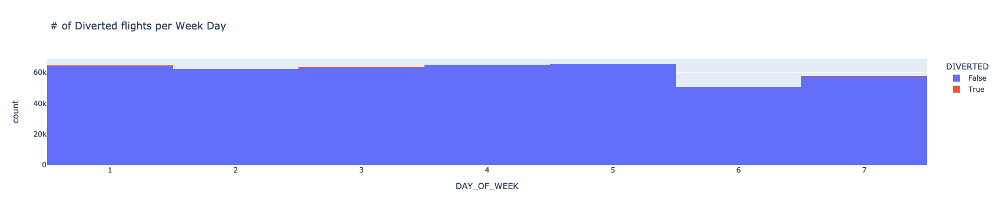

In [24]:
# Number of diverted flights per day of week
fig = plotly_counts(airlines, 'DAY_OF_WEEK', 'DIVERTED', '# of Diverted flights per Week Day')
fig.show()

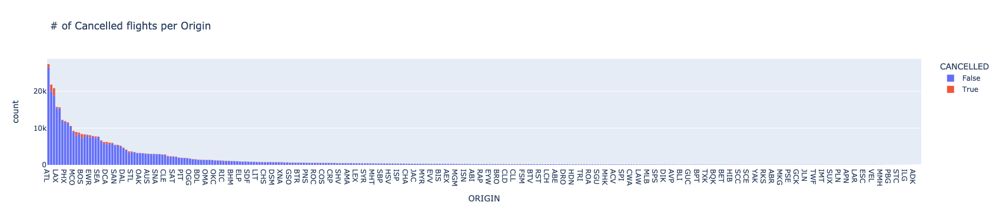

In [25]:
# Most Common origin and Cancellations
fig = plotly_counts(airlines, 'ORIGIN', 'CANCELLED', '# of Cancelled flights per Origin')
fig.show()

We clearly see that only a few number of flights got cancelled or diverted, which means that overall the most common situation is that the flight was succesful, regardless of its delay.

We also observe that the distribution of flights per carrier is skewed towards the carriers `WN`, `DL` or `EV`, which indeed are the top 3 performers. Among this 3 we perceive that even though `EV` has less flights than its partner `DL` its number of cancelled flights is way bigger, reaching almost `WN` numbers.

Regarding the distribution of flights per week day we perceive that its quite constant, more that I would have imagined, most probably because business trips during the week compensate those holidays and joy trips during the weekend. The number of diverted flights has its peak around the end and the start of the week, although it is still almost unnoticeable as during the rest of the week.

The most popular destination is `ATL`, followed by `ORD` and `DWF`. These last two destinations have a proportion of cancelled flights way superior to the one in Atlanta, which shows that they are underperformers in this metric.

#### Numerical Values

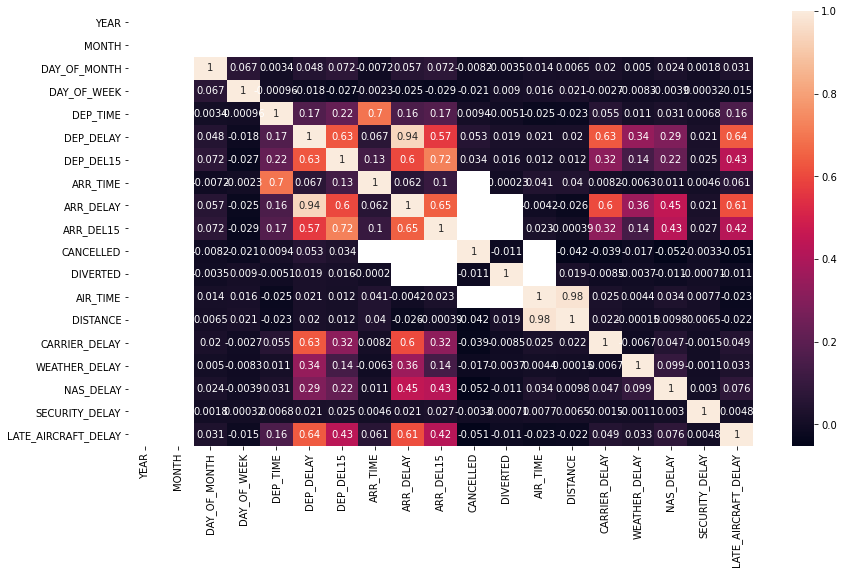

In [26]:
# Plotting correlation of variables
heatmap_corr_values(airlines)

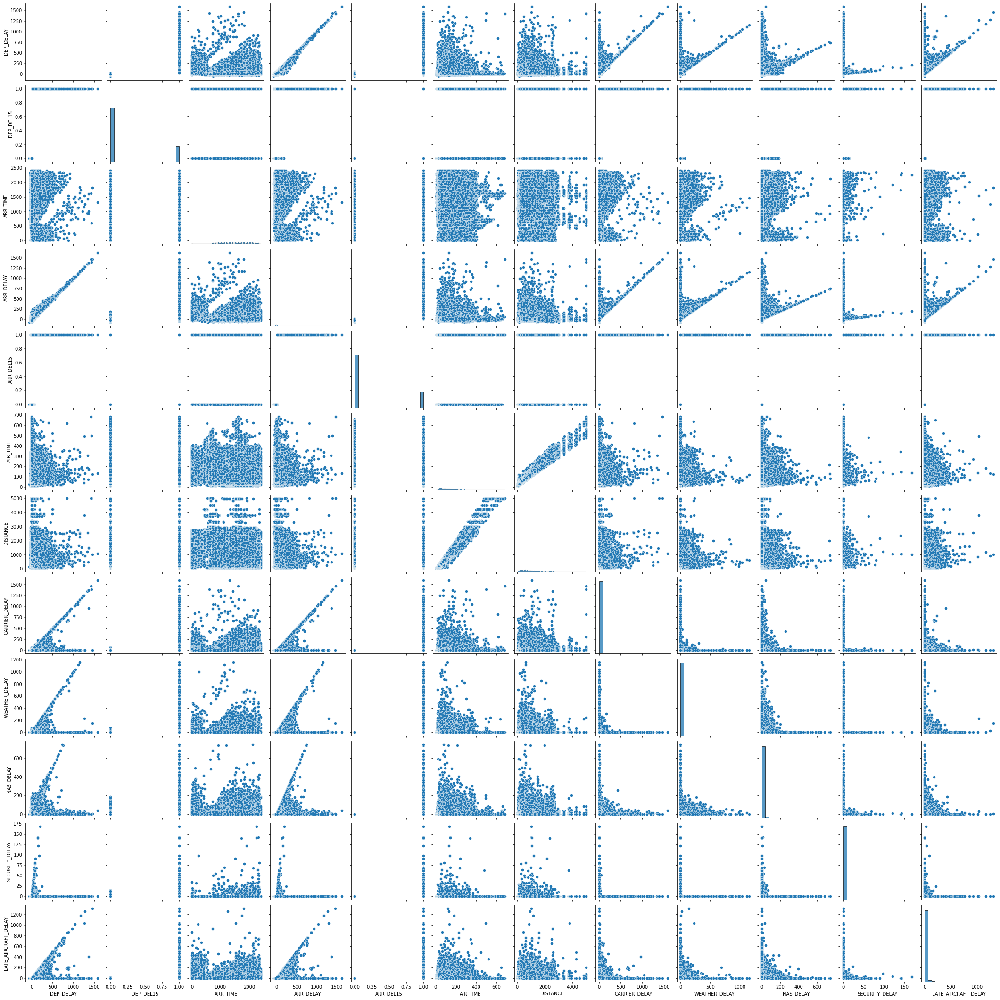

In [27]:
# Distribution of variables - Pairplot
numcols = [
    'DEP_DELAY', 'DEP_DEL15', 'ARR_TIME', 'ARR_DELAY', 'ARR_DEL15',
    'AIR_TIME', 'DISTANCE', 'CARRIER_DELAY', 'WEATHER_DELAY',
    'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY'
]
sns.pairplot(airlines[numcols])
plt.show()

We observe strong and logical correlation between variables as `DEPARTURE_TIME` and `ARRIVAL_TIME` or `CARRIER_DELAY` and `LATE_AIRCRAFT_DELAY`. Those correlations take linear forms in our graphs, identifying clearly which variables depend from others.

In the `pairplot` we also identify clusters of delays around 0 and 600 of `ARR_DELAY`, which then identifies that most of our flights have a delay around that time. Regarding this last column, we also saw that its correlation with the `LATE_AIRCRAFT_DELAY` is of 0.61, which implies that the impact of this last column on the arrival delay is of maximum importance, and that a good number of the total minutes of delay could be explained by a late aircraft.

## Using the Data to Solve our Questions

Now that we took a good look at the data and draw our first conclusions about it we can certainly answers the questions proposed in the introduction of this analysis. Please note that a very high set of questions may be answered from these datasets, but I will focus only on the ones I find more interesting:

### What is the airline with more positive tweets?

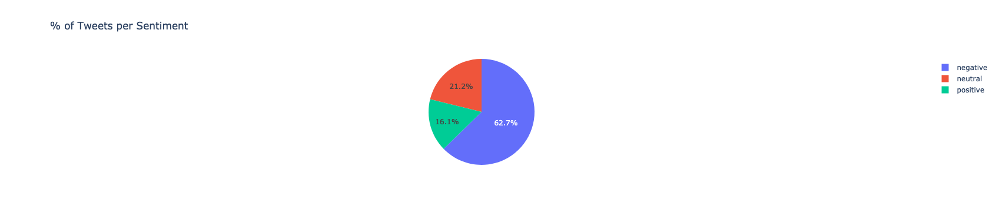

In [28]:
# Grouping by sentiment
grouped_sentiment = tweets.groupby('airline_sentiment').agg({'tweet_id': pd.Series.count}).reset_index()

# Plotting barplot as percentage of total
fig = px.pie(grouped_sentiment, values='tweet_id', names='airline_sentiment', title='% of Tweets per Sentiment')
fig.show()

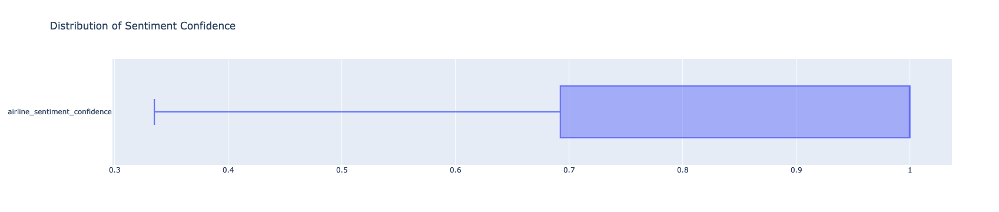

In [29]:
# Distribution of its sentiment scoring
fig = plotly_dist_numcols(tweets, ['airline_sentiment_confidence'], 'box', 'Distribution of Sentiment Confidence')
fig.show()

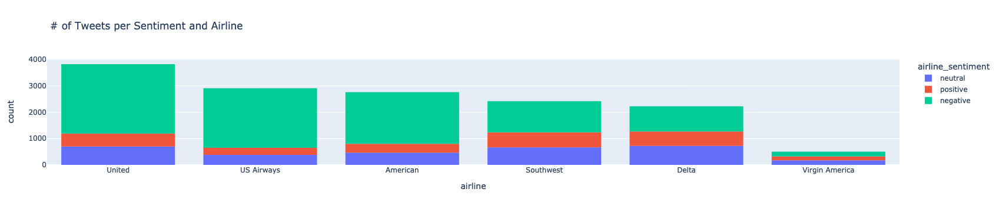

In [30]:
# Reusing code from the Data Description part
fig = plotly_counts(tweets, 'airline', 'airline_sentiment', '# of Tweets per Sentiment and Airline')
fig.show()

The fact that there are much more negative tweets than positive ones induce me to think that the algorithm tends to classify a tweet as negative. Most probably it looks for some certain words and tokens inside the tweet to compute a scoring. Depending of the number of tokens found it computes its scoring, and that scoring determines the sentiment type. Without looking at its code we don't know its ways or scorings, but it is interesting to wonder about them.

As we saw that most of the tweets have a negative sentiment, that relationship applies too to most of the airlines. The airlines which receive the most tweets are the ones with the most negative ones, but funny enought we see that `Southwest` and `Delta`, top 4 and 5 in number of tweets are the top 1 and 2 in positive tweets respectively, which shows that airlines with less presence on the network are the ones receiving the most positive tweets, and therefore its ratio of sentiment type is much better.

### What is the share of tweets and the share of type of sentiment per weekday?

The first step to solve this question would be to extract the weekday from the `tweet_created` column, which would need first to convert this column to a datetime Series:

In [31]:
# Mapping between week days' numbers and names
week_day_names = {
    0: 'Monday',
    1: 'Tuesday',
    2: 'Wednesday',
    3: 'Thursday',
    4: 'Friday',
    5: 'Saturday',
    6: 'Sunday'
}

# Converting tweet_created to datetime
tweets['tweet_created'] = pd.to_datetime(tweets['tweet_created'])

# Extracting day from the tweet_created column
tweets['week_day'] = tweets['tweet_created'].apply(lambda x: week_day_names[x.weekday()])

Now that we managed to extract the weekday as an independent column we may check its distribution across the dataset and the percentage of sentiment types they receive:

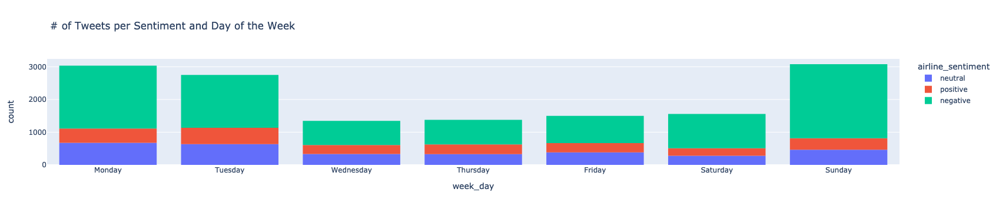

In [32]:
# Plotting countplot of tweets
fig = plotly_counts(tweets, 'week_day', 'airline_sentiment', '# of Tweets per Sentiment and Day of the Week')
fig.update_layout(xaxis={'categoryorder': 'array',
                         'categoryarray': list(week_day_names.values())})
fig.show()

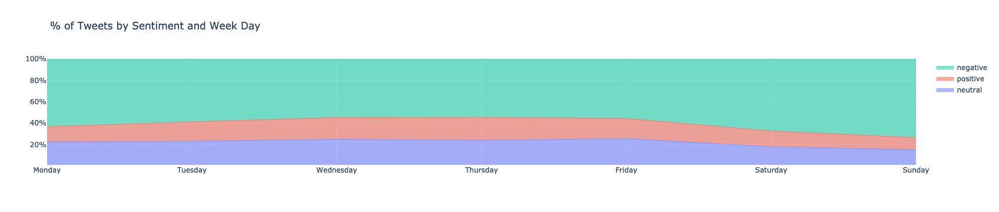

In [33]:
fig = plotly_percentage_grouped(tweets, 'week_day', 'airline_sentiment', '% of Tweets by Sentiment and Week Day')
fig.update_layout(xaxis={'categoryorder': 'array',
                         'categoryarray': list(week_day_names.values())})
fig.show()

The days with the most tweets are Sunday, Monday and Tuesday, in that order, which are also the days with most negative tweets (as it is normal since we saw that in proportion these are the most common tweets). Sunday are also the days with the most negative tweets in proportion, followed by Saturday, which may be due to the presence of problems appearing on weekends while coming home from holidays. Twitter is less charged with airline related tweets during labour days, which may be due to less air traffic during these days or a different profile in travelers (more seasoned travelers who took the plane on a business trip).

Regarding positive and neutral tweets, we see that during the labour days its proportion is bigger, and I would say this is due to the customers asking for information to the Customer Service agents through the social network. Thus, this kind of requests are not negative per se, but instead have a more informative character.

### What is the share of tweets and the share of type of sentiment per hour of the day?

Again, we need to extract some information from the `tweet_created` column, in this case the hour of the tweet. Once it is done we may take a look at the distribution of tweets per hour and sentiment, both in absolute and relative numbers:

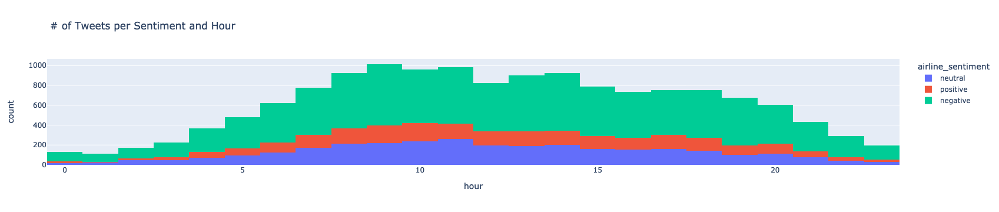

In [34]:
# Extract the hour from the tweet_created column
tweets['hour'] = tweets['tweet_created'].apply(lambda x: x.hour)

# Plotting the tweets per hour of the day and the sentiment type
fig = plotly_counts(tweets, 'hour', 'airline_sentiment', '# of Tweets per Sentiment and Hour')
fig.show()

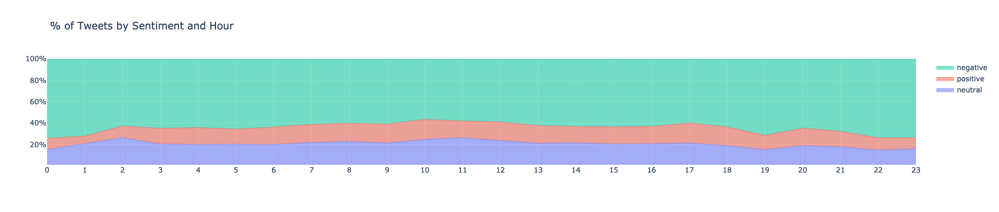

In [35]:
# % of tweets per sentiment according to their hour
fig = plotly_percentage_grouped(tweets, 'hour', 'airline_sentiment', '% of Tweets by Sentiment and Hour')
fig.show()

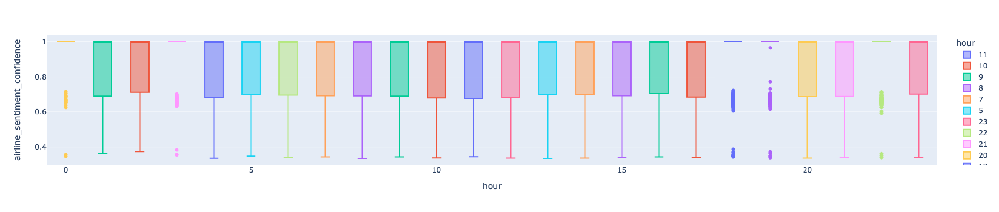

In [36]:
# Correlation between model scoring and the tweet hour
fig = px.box(tweets, x='hour', y='airline_sentiment_confidence', color='hour')
fig.show()

The distribution of tweets by each hour of the day follows a shape similar to the t-student distribution, due to the most tweets being accumulated on the center values (7-19h), as these hours at the central hours of the day and they reflect most of our activity on the social networks.

By looking at the distribution of the ratio of tweets per sentiment, we do not appreciate disruptive changes during the day, although it is clear that during the night the proportion of negative sentiment tweets is bigger. Most probably if one person take time to write a tweet about an airline at 12AM it is going to complain about a particular situation, and therefore the number of negative tweets arise in comparison with positive or neutral ones.

### There is any correlation between the tweets and the delay/cancellation information of the second dataset?

The first thing we should consider while facing this challenge is the following: How should we cross the information?
- Should we use a `merge` on a particular column?
- Should we aggregate the information and perform a join on this/these new source/s? 
- Should we simply compare results on one dataset against the results on the other?

It is clear that depends on the purpose of the analysis, and as the goal here is to correlate the # of tweets and their sentiment differentiating companies, with the # of delayed or cancelled flights per airline, we may use that level of aggregation and group by airline for later on perform our joins, as we would have loved to include the date in our analysis but **the datasets do not collide in the days**.

In [37]:
# Mapping between airlines and carrier codes (source https://airlinecodes.info/)
airline_carrier_mapping = {
    'United': 'UA',
    'US Airways': 'US',
    'American': 'AA',
    'Southwest': 'WN',
    'Delta': 'DL',
    'Virgin America': 'VX'
}

# Creating a carrier column to merge by
tweets['carrier'] = tweets['airline'].apply(lambda x: airline_carrier_mapping[x])

# Pivoting by date, airline and sentiment type
tweet_pivot = tweets.pivot_table(columns='airline_sentiment', index=['carrier'], values='tweet_id', aggfunc='count')
tweet_pivot = tweet_pivot.reset_index().fillna(0)
# Adding percentage of negative tweets
tweet_pivot['% negative'] = tweet_pivot['negative'] / tweet_pivot.iloc[:, 1:].sum(axis=1)

# Pivoting by date and carrier
airline_pivot = airlines.pivot_table(index=['CARRIER'], values=['ARR_DEL15', 'CANCELLED'], aggfunc='sum')
airline_pivot = airline_pivot.reset_index().fillna(0)
# Adding number of flights and calculating delays and Cancelled
total_flights_airline = pd.DataFrame(airlines.CARRIER.value_counts()).reset_index()
total_flights_airline.columns = ['CARRIER', 'TOTAL_FLIGHTS']
airline_pivot = airline_pivot.merge(total_flights_airline, on='CARRIER')

airline_pivot['% DELAY'] = airline_pivot['ARR_DEL15'] / airline_pivot['TOTAL_FLIGHTS']
airline_pivot['% CANCELLED'] = airline_pivot['CANCELLED'] / airline_pivot['TOTAL_FLIGHTS']

# Merging both dataframes leaving tweet data
merged_data = tweet_pivot.merge(airline_pivot, how='left',
                                left_on=['carrier'],
                                right_on=['CARRIER']).drop('CARRIER', axis=1)

# Inspecting the results
merged_data

,carrier,negative,neutral,positive,% negative,ARR_DEL15,CANCELLED,TOTAL_FLIGHTS,% DELAY,% CANCELLED
0,AA,1960,463,336,0.710402,7925.0,2554,39835,0.198946,0.064114
1,DL,955,723,544,0.429793,11586.0,1696,60884,0.190296,0.027856
2,UA,2633,697,492,0.688906,8491.0,1006,36235,0.234331,0.027763
3,US,2263,381,269,0.776862,6574.0,1574,30153,0.218021,0.052200
4,VX,181,171,152,0.359127,839.0,155,4223,0.198674,0.036704
5,WN,1186,664,570,0.490083,16624.0,3454,90172,0.184359,0.038305


Now that we performed the merge of our information, it is time to plot it to retrieve insights:

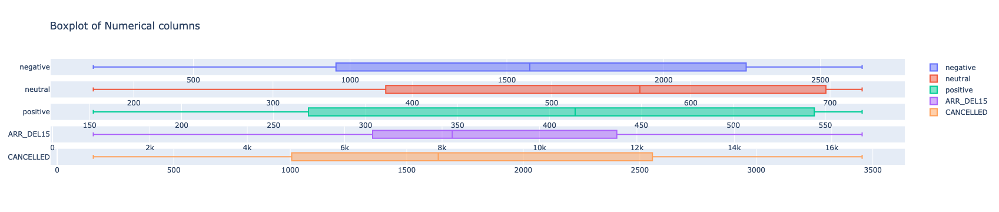

In [38]:
# Distribution of variables
numcols = [
    'negative',
    'neutral',
    'positive',
    'ARR_DEL15',
    'CANCELLED'
]
fig = plotly_dist_numcols(merged_data, numcols, 'box', 'Boxplot of Numerical columns')
fig.show()

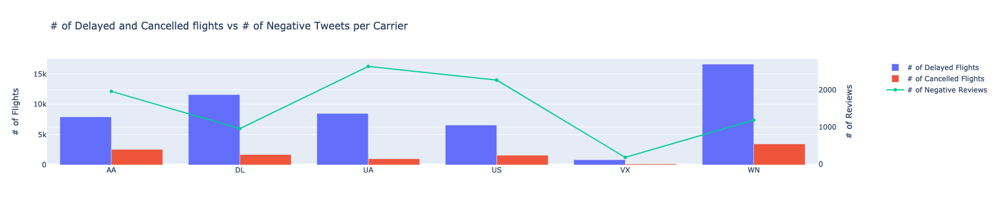

In [39]:
# Distribution of variables per Carrier
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Bar(x=merged_data.carrier, y=merged_data['ARR_DEL15'], name='# of Delayed Flights')
)
fig.add_trace(
    go.Bar(x=merged_data.carrier, y=merged_data['CANCELLED'], name='# of Cancelled Flights')
)
fig.add_trace(
    go.Scatter(x=merged_data.carrier, y=merged_data['negative'], name='# of Negative Reviews'),
    secondary_y=True
)
fig.update_yaxes(title_text="# of Flights", secondary_y=False)
fig.update_yaxes(title_text="# of Reviews", secondary_y=True)
fig.update_layout(title='# of Delayed and Cancelled flights vs # of Negative Tweets per Carrier')
fig.show()

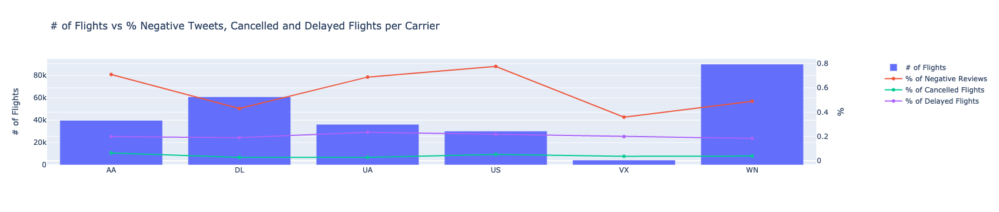

In [40]:
# Distribution of variables per Carrier
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Bar(x=merged_data.carrier, y=merged_data['TOTAL_FLIGHTS'], name='# of Flights')
)
fig.add_trace(
    go.Scatter(x=merged_data.carrier, y=merged_data['% negative'], name='% of Negative Reviews'),
    secondary_y=True
)
fig.add_trace(
    go.Scatter(x=merged_data.carrier, y=merged_data['% CANCELLED'], name='% of Cancelled Flights'),
    secondary_y=True
)
fig.add_trace(
    go.Scatter(x=merged_data.carrier, y=merged_data['% DELAY'], name='% of Delayed Flights'),
    secondary_y=True
)
fig.update_yaxes(title_text="# of Flights", secondary_y=False)
fig.update_yaxes(title_text="%", secondary_y=True)
fig.update_layout(title='# of Flights vs % Negative Tweets, Cancelled and Delayed Flights per Carrier')
fig.show()

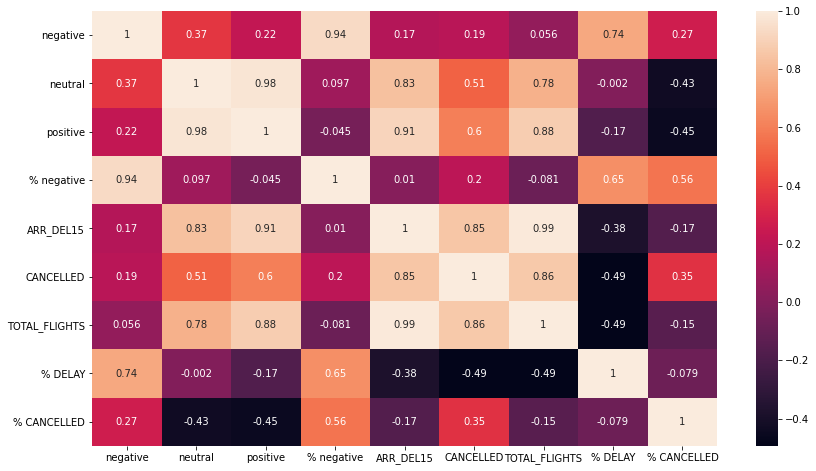

In [41]:
# Correlation of the variables
heatmap_corr_values(merged_data)

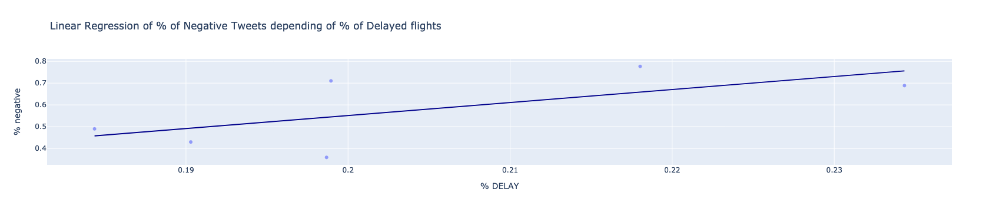

In [42]:
# Regression plots
fig = px.scatter(
    merged_data, x='% DELAY', y='% negative', opacity=0.65,
    trendline='ols', trendline_color_override='darkblue',
    title='Linear Regression of % of Negative Tweets depending of % of Delayed flights'
)
fig.show()

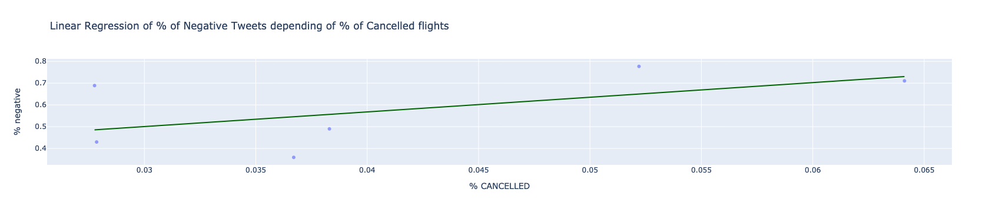

In [43]:
# Regression plots
fig = px.scatter(
    merged_data, x='% CANCELLED', y='% negative', opacity=0.65,
    trendline='ols', trendline_color_override='darkgreen',
    title='Linear Regression of % of Negative Tweets depending of % of Cancelled flights'
)
fig.show()

The first thing we noticed whilst analyzing this data is that the airlines with the most Cancelled or Delayed flights are not the ones receiving more negative tweets, which may seem odd. Indeed, if we look at the correlation matrix inside our heatmap we see that the number of total flights affects greatly the number of positive and neutral tweets, but not the one for negative sentiment tweets, getting a negative correlation of -0.18 between the number of flights and the ratio of negative reviews. Therefore, our first insight is that **airlines with more flights tend to have more happy customers** (or at least more positive tweets), even though considering the case of Virgin America, which has a small number of flights but also percentage of negative tweets.

On the other hand, what does indeed increase the percentage of negative reviews is not the # of Cancelled or Delayed flights, but its ratio! If we look at the correlation matrix again strong correlations between the first variable and the other two (0.65 and 0.56 respectively, which means that Delayed flights have a bigger impact on customers' tweets). We try to fit two simple linear regressions only to check the slope and get a graphical idea of this correlations, and they explained 42 and 32% of the variance of the ratio of negative reviews. Therefore, our second insight is that **companies with a bigger percentage of delayed and cancelled flights have a bigger ratio of negative sentiment tweets**.

### Which are the most common words on the tweets according to their sentiment type?

We may well check the most used words inside the tweets of each sentiment type, and therefore have a glance of how the users compose their requests and some subtle information of how the model may have differentiated these types among the tweets:

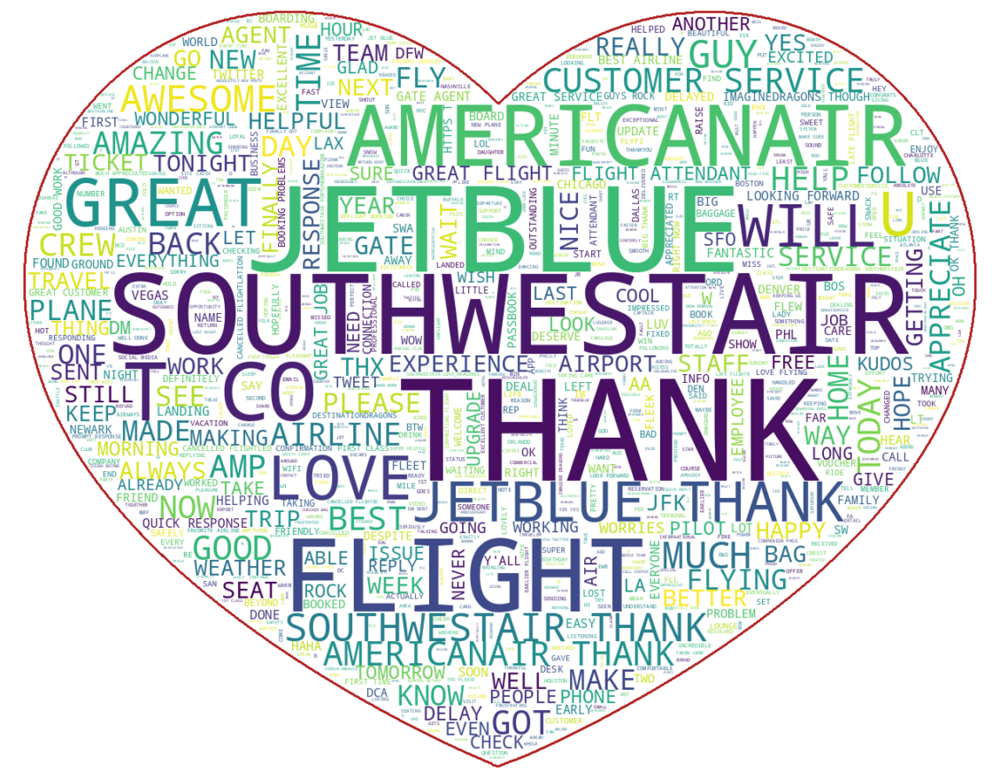

In [44]:
# Positive Sentiments
wordcloud_sentiment(tweets, 'positive', 1000, '../img/heart-png.png')

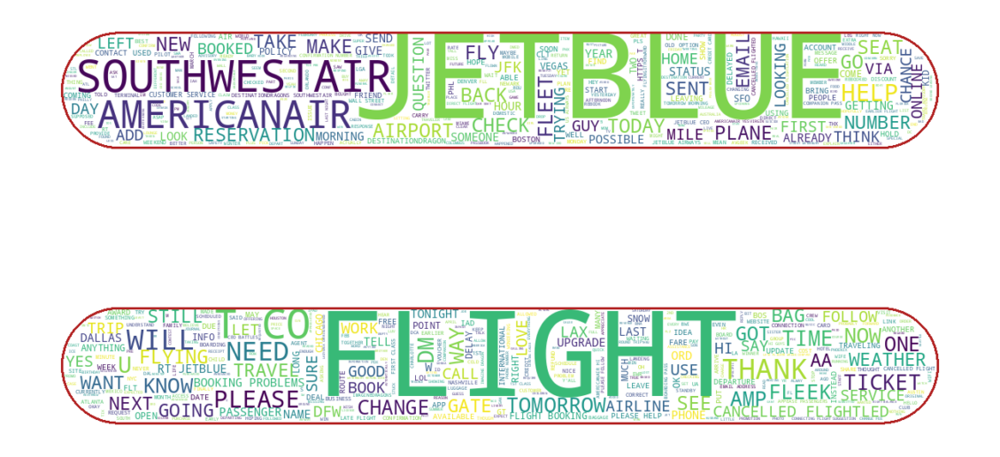

In [45]:
# Neutral Sentiments
wordcloud_sentiment(tweets, 'neutral', 1000, '../img/equal.png')

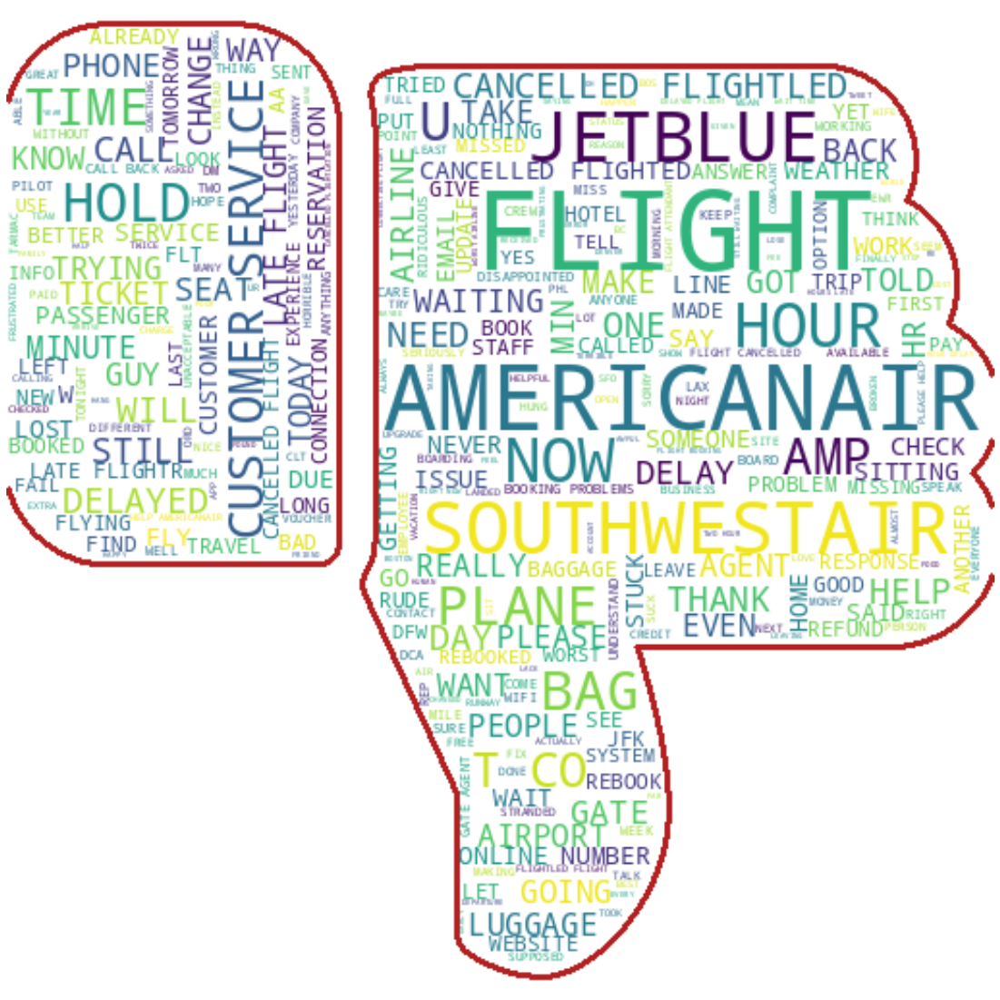

In [46]:
# Negative Sentiments
wordcloud_sentiment(tweets, 'negative', 1000, '../img/dislike-pngrepo-com.png')

As we see looking at these wordclouds, independently of the sentiment there are some words that are always among the most present ones with airline related tweets, some of which field related as `Flight` or some companies' names such as `AmericanAir` or `Jetblue`, but we also perceive some differences between the sentiment types:
1. Positive tweets tend to have the word `THANK` quite present, as well as some other beautiful words as `LOVE` or `AWESOME`.
2. Neutral tweets have information and enquiries vocabulary, such as `PLEASE`, `TICKET` or `HELP`.
3. Negative tweets have some very specific words as `CANCELLED`, `CUSTOMER SERVICE` or `LATE FLIGHT` that indicate disgust.

Therefore, different sentiment tweets use a base vocabulary plus an extra layer of differentiating terms that we now are aware of.

### There is any correlation between the tweet size and its sentiment?

Now that we have analyzed the most common words per tweet sentiment, I think it may be usefull also to take a look at the word count distribution, just to check if the lenght of a tweet varies of the sentiment of our message:

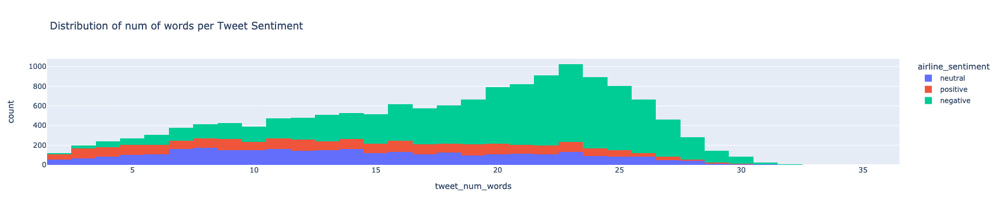

In [47]:
# Get length in words per tweet
tweets['tweet_num_words'] = tweets['text'].apply(lambda x: len(x.split()))

# Plotting its frequency
fig = px.histogram(tweets, x='tweet_num_words', color='airline_sentiment',
                   title='Distribution of num of words per Tweet Sentiment')
fig.show()

The first thing to check is that the max number of words per tweet is 36, which is logic knowing the character limitations of this particular social network.

As one may suspect, tweets with worse sentiment have more words per tweet, being the mode of the negative tweets 23 words, far from the ones of the neutral and positive sentiments (8 and 9 respectively). This change in central tendency also affects the mean and changes the whole form of the distribution, being the negative word lenght skewed towards the right of the distribution and both the neutral and the positive ones skewed towards the left (although very less).

We obtain from this that indeed angry customers tend to express themselves on a larger way than the rest of the customers.

### Which are the main estimators that determine the arrival delay of an aircraft?

Lastly, we may also fit a regression model on our airline data using the `ARR_DELAY` variable as a target, therefore infering the main reasons behind the time delayed on arrival. As this model will be used on a statistical perspective (confidence and strenght of the indicators) more than on a machine learning approach (based on predictions and scorings), we will be using all our data in the training.

In [48]:
# Only a subset of columns is considered
columns_considered = [
    'DAY_OF_WEEK', 'DEP_DELAY', 'DIVERTED', 'AIR_TIME', 'DISTANCE'
]

# Building the model for statistical purposes
mod = smf.ols(formula=f'ARR_DELAY ~ {" + ".join(columns_considered)}', data=airlines).fit()
mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              ARR_DELAY   R-squared:                       0.895
Model:                            OLS   Adj. R-squared:                  0.895
Method:                 Least Squares   F-statistic:                 8.732e+05
Date:                Mon, 16 Aug 2021   Prob (F-statistic):               0.00
Time:                        11:06:04   Log-Likelihood:            -1.6530e+06
No. Observations:              407663   AIC:                         3.306e+06
Df Residuals:                  407658   BIC:                         3.306e+06
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
Intercept           -5.1569      0.063    -82.198      0.000      -5.280      -5.034
DIVERTED[T.True]  -6.94e-13   8.44e-15    -82.229      0.000   -7.11e-13   -6.77e-13
DAY_OF_WEEK         -0.1394      0.011    -12.430      0.000      -0.161      -0.117
DEP_DELAY            1.0198      0.001   1856.802      0.000       1.019       1.021
AIR_TIME             0.2654      0.001    181.943      0.000       0.263       0.268
DISTANCE            -0.0346      0.000   -196.261      0.000      -0.035      -0.034
==============================================================================
Omnibus:                   195301.443   Durbin-Watson:                   1.673
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          2938161.297
Skew:                           1.931   Prob(JB):                         0.00
Kurtosis:                      15.572   Cond. No.                     6.30e+18
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.05e-26. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

As we may see, our model has an adjusted R2 score of 0.895, which means that these 5 variables explain almost 90% of the variability of our target column. Thus, we see clear their correlation, which is also 
backed up by the p-values of the variables. Nevertheless, we must be careful as this good score in R2 is mainly due to the presence of the variable `DEP_DELAY`, whose coefficient is quite close to 1.00 and has a minimum standard error, meaning that these two variables correlate each other almost as a perfect linear function.

The coefficients of the variables allowed us to see that the more `AIR_TIME` a flight has, the higher its `ARR_DELAY`, which may make sense. On the other hand, it is quite bizarre to notice that the `DISTANCE` between the origin and the destination have a negative relationship with its `ARR_DELAY`, although it is quite close to 0. The fact that a flight is `DIVERTED` has an impact close to 0 in the arrival delay, whereas the `DAY_OF_WEEK` has a negative effect, meaning that flights tend to be delayed more minutes in the beggining of the week and a negative correlation exists (although again, quite small, -0.14 minutes per day from Monday).

## Conclusions and Main Insights

Another analysis done! This time as a conclusion I would like to highlight the most important facts of each point:

We saw that negative sentiments are the kings in our dataset, being 62.7% of it. This fact is also reflected on the distribution of our scoring column, which has a Q1 of 0.7 and a max = Q4 of 1, which indeed shows an skewed distribution towards higher values.

If we look at our data grouping by the airlines mentioned in those tweets, we perceive that the companies which accumulate less mentions are the ones that have a smaller ratio of negative sentiment tweets, not reaching the 50% even. These companies are Virgin, Delta and Southwest. This may show that people tend to be more present when they have a negative opinion than when they have a positive one, which we mentioned before and is key to understand this point.

Regarding the timestamp of our tweets, we do see that the weekdays between Saturday and Tuesday (in that direction) have a much higher ratio of negative sentiment tweets. This fact as we mentioned too may show that the people travel more during the weekends, and with higher demands (due to higher prices of flights or different profiles of the consumers). On the other hand, if we look at the hour of each tweet, we also observe a clear difference on ratio and number: Late hours are for complaints. In our graphs it is clear that hours such as midnight or 1 AM have a high ratio of negatives, which may be related to most of the people willing to tweet about an airline at those hours are people who seek for help or want to denunciate a problem with the company.

While looking at the other dataset, this time about cancellations and delays of flights around the same dates (although not exactly the same) we perceive two basic facts:
1. Companies with more flights are also the ones with a lesser ratio of negative sentiment tweets. This may be due because of a cyclic relationship here: People choose airlines with better customer scoring, this company flights more and gain more experience, which leads to more experience and better customer experience.
2. The % of Delayed and Cancelled flights per company affects negatively the ratio of negative sentiment tweets, and we perceive a high correlation between this column and those two mentioned earlier (0,65 and 0,56 repectively).

Finally, we manage to give some extra hints perceived during the dataset, and of those I would like to highlight that:
1. There is a common set of words used during airline related tweets regardless of their sentiment. Although, there is an extra layer of words such as Thank or Delay that correspond to a type of sentiment only (respectively positive and negative ones).
2. Negative tweets tend to use more words, as they want to explain their opinions and cases and are more willing to spend time of these tweets. Therefore, we would expect larger tweets to have a higher percentage to be negative.
3. Arrival delays are mostly explained by a subset of variables at almost at a 90% ratio. Although, the one variable that explains most of the variance of this column is the delay on departure, which statistically has a coefficient of 1,02 aproximately, meaning that the relationship is almost perfectly linear.